In [1]:
# Import libraries
'''Main'''
import numpy as np
import pandas as pd
import os, time
import pickle, gzip

In [2]:
'''Data Viz'''
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
import matplotlib as mpl
%matplotlib inline

In [3]:
'''Data Prep and Model Evaluation'''
from sklearn import preprocessing as pp
from scipy.stats import pearsonr
from numpy.testing import assert_array_almost_equal
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import log_loss
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import roc_curve, auc, roc_auc_score
from sklearn.metrics import confusion_matrix, classification_report

In [4]:
'''Algos'''
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
import lightgbm as lgb

In [5]:
from sklearn.datasets import


ImportError: cannot import name 'iris' from 'sklearn.datasets' (/home/abhishek/anaconda3/envs/testProject/lib/python3.8/site-packages/sklearn/datasets/__init__.py)

In [6]:
!ls


credit_card_fraud_detection.ipynb  data
csv_log_reg.sav			   dimensionality_reduction.ipynb


In [7]:
!pwd

/code/credit_card_unsupervised


In [11]:
import os
dataset_file = os.path.join(os.getcwd(),"data","mnist.pkl.gz")

In [12]:
dataset_file

'/code/credit_card_unsupervised/data/mnist.pkl.gz'

In [13]:
f = gzip.open(dataset_file, 'rb')

In [14]:
train_set, validation_set, test_set = pickle.load(f, encoding='latin1')

In [15]:
f.close()

In [18]:
train_set[0].shape

(50000, 784)

In [19]:
X_validation, y_validation = validation_set[0], validation_set[1]

In [20]:
X_train, y_train = train_set[0], train_set[1]

In [21]:
X_test, y_test = test_set[0], test_set[1]

In [22]:
print("Shape of X_train: ", X_train.shape)
print("Shape of y_train: ", y_train.shape)
print("Shape of X_validation: ", X_validation.shape)
print("Shape of y_validation: ", y_validation.shape)
print("Shape of X_test: ", X_test.shape)
print("Shape of y_test: ", y_test.shape)

Shape of X_train:  (50000, 784)
Shape of y_train:  (50000,)
Shape of X_validation:  (10000, 784)
Shape of y_validation:  (10000,)
Shape of X_test:  (10000, 784)
Shape of y_test:  (10000,)


In [23]:
#let's create pandas dataframe from the datasets
train_index = range(0,len(X_train))

In [24]:
train_index

range(0, 50000)

In [25]:
validation_index = range(len(X_train),len(X_train)+len(X_validation))

In [26]:
validation_index

range(50000, 60000)

In [28]:
test_index = range(len(X_train)+len(X_validation),len(X_train)+len(X_validation)+len(X_test))

In [29]:
test_index

range(60000, 70000)

In [36]:
X_train = pd.DataFrame(data=X_train,index=train_index)
y_train = pd.Series(data=y_train,index=train_index)
X_validation = pd.DataFrame(data=X_validation,index=validation_index)
y_validation = pd.Series(data=y_validation,index=validation_index)
X_test = pd.DataFrame(data=X_test,index=test_index)
y_test = pd.Series(data=y_test,index=test_index)

In [35]:
X_train.describe()

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
count,50000.0,50000.0,50000.0,50000.0,50000.0,50000.0,50000.0,50000.0,50000.0,50000.0,...,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.0,50000.0,50000.0,50000.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000739,0.000354,0.000204,0.000090,0.000071,0.000009,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.022784,0.015424,0.012080,0.007218,0.007181,0.001483,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.992188,0.992188,0.988281,0.988281,0.992188,0.242188,0.0,0.0,0.0,0.0


In [71]:
X_train.tail()

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
49995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
49999,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [41]:
y_train.head()

0    5
1    0
2    4
3    1
4    9
dtype: int64

In [42]:
#function to view the images
def view_digit(example):
    label = y_train.loc[0]
    image = X_train.loc[example,:].values.reshape([28,28])
    plt.title('Example: %d Label: %d' % (example, label))
    plt.imshow(image, cmap=plt.get_cmap('gray'))
    plt.show()

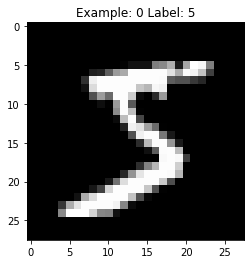

In [43]:
view_digit(0)

In [50]:
y_train.describe()

count    50000.000000
mean         4.448840
std          2.891296
min          0.000000
25%          2.000000
50%          4.000000
75%          7.000000
max          9.000000
dtype: float64

In [51]:
#PCA in practice
# we have to run feature scaling before doing PCA

from sklearn.decomposition import PCA
n_components = 784 
whiten = False
random_state = 2018

pca = PCA(n_components=n_components, whiten=whiten,random_state=random_state)

In [52]:
pca

PCA(n_components=784, random_state=2018)

In [53]:
X_train_PCA = pca.fit_transform(X_train)

In [54]:
X_train_PCA = pd.DataFrame(data=X_train_PCA, index=train_index)

In [56]:
X_train_PCA.head()

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0.461509,-1.246865,0.046374,-2.151917,-0.247400,-0.925437,0.889344,0.507090,-1.541712,0.689378,...,-0.000000e+00,0.0,0.0,0.0,0.0,1.777759e-05,-0.000000e+00,-0.000000e+00,0.000000e+00,0.000000e+00
1,3.921687,-1.251671,2.335532,-1.340526,-3.421538,-0.725560,-0.206397,-0.345264,0.134142,0.595467,...,3.760059e-10,0.0,0.0,0.0,0.0,4.112185e-08,-2.727943e-06,7.358929e-07,1.364601e-06,-2.749954e-07
2,-0.203692,1.547942,-0.980408,2.039101,-1.079774,0.112965,-3.312374,1.403185,-0.592926,-0.763883,...,-5.918390e-10,0.0,0.0,0.0,0.0,1.077690e-07,-1.801470e-08,4.267714e-07,1.620178e-06,-3.071570e-08
3,-3.148429,-2.296119,1.091197,0.484574,0.066977,2.778971,-1.834327,-0.174684,1.166472,0.052838,...,-3.111814e-10,0.0,0.0,0.0,0.0,5.204616e-08,-4.940958e-07,-7.838253e-07,4.692367e-07,-8.326928e-08
4,-1.442697,2.872046,0.175512,-0.976986,0.302763,0.120634,-0.376727,-1.478096,1.003816,0.540792,...,1.007389e-09,0.0,0.0,0.0,0.0,-3.503779e-08,1.988287e-06,-7.596450e-07,-9.897813e-07,3.818067e-07


In [57]:
X_train.head()

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [60]:
#We haven't reduced the dimensionality at all
sum(pca.explained_variance_ratio_) #variance of original data captured by the 784 principal components should be 100%

0.9999999840124945

In [61]:
importanceOfPrincipalComponents = pd.DataFrame(data=pca.explained_variance_ratio_)

In [62]:
importanceOfPrincipalComponents = importanceOfPrincipalComponents.T

In [63]:
importanceOfPrincipalComponents.head()

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0.097444,0.070598,0.062161,0.053795,0.048581,0.043196,0.032776,0.028864,0.027688,0.023659,...,1.254956e-16,1.254956e-16,1.254956e-16,1.254956e-16,1.254956e-16,1.230116e-16,7.566568e-17,2.455228e-17,1.418824e-17,4.507609e-18


In [64]:
print('Variance Captured by First 10 Principal Components: ',
importanceOfPrincipalComponents.loc[:,0:9].sum(axis=1).values)
print('Variance Captured by First 20 Principal Components: ',
importanceOfPrincipalComponents.loc[:,0:19].sum(axis=1).values)
print('Variance Captured by First 50 Principal Components: ',
importanceOfPrincipalComponents.loc[:,0:49].sum(axis=1).values)
print('Variance Captured by First 100 Principal Components: ',
importanceOfPrincipalComponents.loc[:,0:99].sum(axis=1).values)
print('Variance Captured by First 200 Principal Components: ',
importanceOfPrincipalComponents.loc[:,0:199].sum(axis=1).values)
print('Variance Captured by First 300 Principal Components: ',
importanceOfPrincipalComponents.loc[:,0:299].sum(axis=1).values)

Variance Captured by First 10 Principal Components:  [0.4887624]
Variance Captured by First 20 Principal Components:  [0.64398026]
Variance Captured by First 50 Principal Components:  [0.82486093]
Variance Captured by First 100 Principal Components:  [0.91465855]
Variance Captured by First 200 Principal Components:  [0.96650076]
Variance Captured by First 300 Principal Components:  [0.9862489]


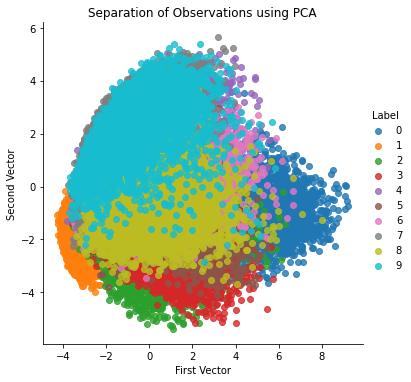

In [104]:
#The first 300 capture almost 99% of the information in the data. The rest of the principal components is of negligible value
#let's visualize the separation of points in space

def scatterPlot(xDF,yDF,algoName):
    tempDF = pd.DataFrame(data=xDF.loc[:,0:1], index=xDF.index)
    tempDF = pd.concat((tempDF,yDF), axis=1, join="inner")
    tempDF.columns = ["First Vector", "Second Vector", "Label"]
    sns.lmplot(x="First Vector", y="Second Vector", hue="Label",data=tempDF, fit_reg=False)
    ax = plt.gca()
    ax.set_title("Separation of Observations using "+algoName)
scatterPlot(X_train_PCA, y_train, "PCA")

In [100]:
X_train_PCA.loc[:,:2]

,0,1,2
0,0.461509,-1.246865,0.046374
1,3.921687,-1.251671,2.335532
2,-0.203692,1.547942,-0.980408
3,-3.148429,-2.296119,1.091197
4,-1.442697,2.872046,0.175512
...,...,...,...
49995,1.147861,-1.973071,-3.739088
49996,1.416360,-0.252646,-0.809299
49997,-1.425062,-1.957855,-2.551206
49998,-1.507427,1.025313,0.107807


In [68]:
#Images of the same digit are closer to one another than images of another digits
X_train_PCA.head()

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0.461509,-1.246865,0.046374,-2.151917,-0.247400,-0.925437,0.889344,0.507090,-1.541712,0.689378,...,-0.000000e+00,0.0,0.0,0.0,0.0,1.777759e-05,-0.000000e+00,-0.000000e+00,0.000000e+00,0.000000e+00
1,3.921687,-1.251671,2.335532,-1.340526,-3.421538,-0.725560,-0.206397,-0.345264,0.134142,0.595467,...,3.760059e-10,0.0,0.0,0.0,0.0,4.112185e-08,-2.727943e-06,7.358929e-07,1.364601e-06,-2.749954e-07
2,-0.203692,1.547942,-0.980408,2.039101,-1.079774,0.112965,-3.312374,1.403185,-0.592926,-0.763883,...,-5.918390e-10,0.0,0.0,0.0,0.0,1.077690e-07,-1.801470e-08,4.267714e-07,1.620178e-06,-3.071570e-08
3,-3.148429,-2.296119,1.091197,0.484574,0.066977,2.778971,-1.834327,-0.174684,1.166472,0.052838,...,-3.111814e-10,0.0,0.0,0.0,0.0,5.204616e-08,-4.940958e-07,-7.838253e-07,4.692367e-07,-8.326928e-08
4,-1.442697,2.872046,0.175512,-0.976986,0.302763,0.120634,-0.376727,-1.478096,1.003816,0.540792,...,1.007389e-09,0.0,0.0,0.0,0.0,-3.503779e-08,1.988287e-06,-7.596450e-07,-9.897813e-07,3.818067e-07


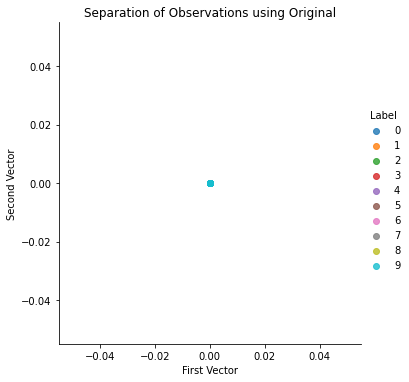

In [69]:
#let's check the data using original dataset
scatterPlot(X_train, y_train, "Original")

In [73]:
X_train.shape

(50000, 784)

In [74]:
y_train.shape

(50000,)

In [75]:
#Incremental PCA
from sklearn.decomposition import IncrementalPCA

In [78]:
n_components = 784
batch_size = 2

incrementalPCA = IncrementalPCA(n_components=n_components,batch_size=None)

In [79]:
X_train_incrementalPCA = incrementalPCA.fit_transform(X_train)

In [80]:
X_train_incrementalPCA = pd.DataFrame(data=X_train_incrementalPCA, index=train_index)

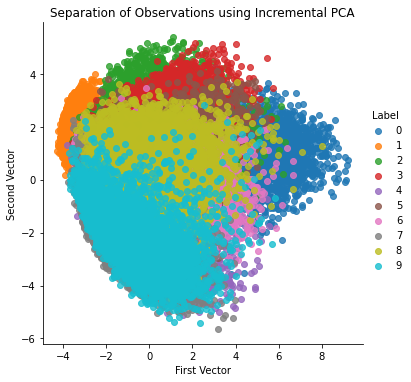

In [81]:
scatterPlot(X_train_incrementalPCA, y_train, "Incremental PCA")

In [105]:
from sklearn.decomposition import SparsePCA

In [108]:
n_components = 100
alpha = 0.0001
random_state = 2018  
n_jobs = -1
sparsePCA = SparsePCA(n_components=n_components, \
alpha=alpha, random_state=random_state, n_jobs=n_jobs)

In [109]:
sparsePCA.fit(X_train.loc[:10000,:])

SparsePCA(alpha=0.0001, n_components=100, n_jobs=-1, random_state=2018)

In [110]:
#Singular value decomposition
from sklearn.decomposition import TruncatedSVD
n_components = 200
algorithm = 'randomized'
n_iter = 5
random_state = 2018

In [111]:
svd = TruncatedSVD(n_components=n_components, algorithm=algorithm, n_iter=n_iter, random_state=random_state)

In [112]:
X_train_svd = svd.fit_transform(X_train)

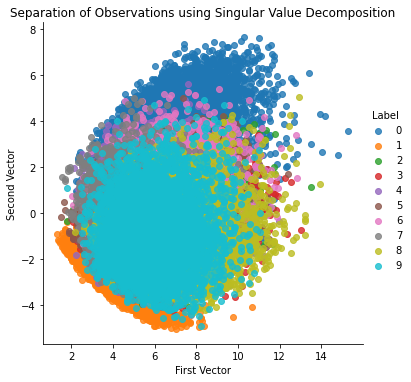

In [113]:
X_train_svd = pd.DataFrame(data=X_train_svd, index=train_index)
X_validation_svd = svd.transform(X_validation)
X_validation_svd = pd.DataFrame(data=X_validation_svd, index=validation_index)

scatterPlot(X_train_svd, y_train, "Singular Value Decomposition")

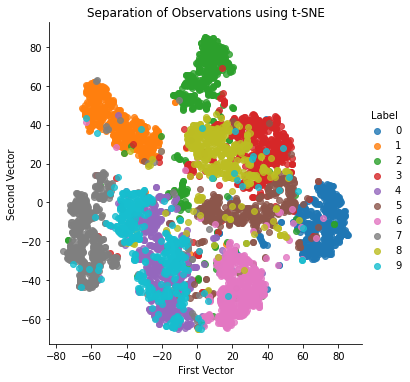

In [114]:
from sklearn.manifold import TSNE
n_components = 2
learning_rate = 300
perplexity = 30
early_exaggeration = 12
init = 'random'
random_state = 2018
tSNE = TSNE(n_components=n_components, learning_rate=learning_rate, \
perplexity=perplexity, early_exaggeration=early_exaggeration, \
init=init, random_state=random_state)

X_train_tSNE = tSNE.fit_transform(X_train_PCA.loc[:5000,:9])
X_train_tSNE = pd.DataFrame(data=X_train_tSNE, index=train_index[:5001])
scatterPlot(X_train_tSNE, y_train, "t-SNE")

In [120]:
X_train_PCA.loc[:5000,:9].shape

(5001, 10)

In [122]:
X_train_tSNE.shape

(5001, 2)

In [ ]:
#Let's try ICA. ICA is used to separate out blended signals into their individual components.
#After the separation is complete, we can reconstruct any of the original features by adding some combination of the individual components we generate.
#Independent component Analysis

from sklearn.decomposition import FastICA
n_components = 25
algorithm = 'parallel'
whiten = True
max_iter = 100
random_state = 2018
fastICA = FastICA(n_components=n_components, algorithm=algorithm,whiten=whiten, max_iter=max_iter,random_state=random_state)
X_train_fastICA = fastICA.fit_transform(X_train)
X_train_fastICA = pd.DataFrame(data=X_train_fastICA, index=train_index)


X_validation_fastICA = fastICA.transform(X_validation)
X_validation_fastICA = pd.DataFrame(data=X_validation_fastICA, index=validation_index)

scatterPlot(X_train_fastICA, y_train, "Independent Component Analysis")